# init

In [2]:
import io
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

from pprint import pprint

import pylab
import calendar
import numpy as np
import pandas as pd
import seaborn as sn
from scipy import stats

from datetime import datetime, timedelta
import pytz

import plotly.express as px

import seaborn as sns  #for data visualization operations
import matplotlib.pyplot as plt  #for data visualization operations

import folium
import statistics

import xml.etree.ElementTree as ET
import urllib.request

import requests


In [3]:
import math

def distance(origin, destination):
    """
    Calculate the Haversine distance.

    Parameters
    ----------
    origin : tuple of float
        (lat, long)
    destination : tuple of float
        (lat, long)

    Returns
    -------
    distance_in_km : float

    Examples
    --------
    >>> origin = (48.1372, 11.5756)  # Munich
    >>> destination = (52.5186, 13.4083)  # Berlin
    >>> round(distance(origin, destination), 1)
    504.2
    """
    lat1, lon1 = origin
    lat2, lon2 = destination
    radius = 6371  # km
    if (lat1 == lat2) & (lon1 == lon2):
        return 0
    elif (lat1 == 0) | (lat2 == 0):
        return 0
    else:
        dlat = math.radians(lat2 - lat1)
        dlon = math.radians(lon2 - lon1)
        a = (math.sin(dlat / 2) * math.sin(dlat / 2) +
            math.cos(math.radians(lat1)) * math.cos(math.radians(lat2)) *
            math.sin(dlon / 2) * math.sin(dlon / 2))
        c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
        d = radius * c

        return d

distance((52.2296756, 21.0122287), (52.406374, 16.9251681))

278.45817507541943

# Target
* Cover Slide
* Agenda – What will be discussed in the presentation?
* Background – What is the context of this project?
* Descriptions and location of related data.
* Any known issues with the data and how you plan to address them.
* Descriptive/ Inferential statistics you gathered as an initial step in analysis.
* High-Level Recommendations – Three or more recommendations about the existing data. What would you change or add to the data?
* Closing Slide


To run it: jupyter-nbconvert.exe .\slideshow.ipynb --to slides --post serve 

# Presentation

## 1 Cover Slide

<style type="text/css">

.reveal p {
    font-family: 'Raleway', sans-serif;
}

div.warn {    
    background-color: #fcf2f2;
    border-color: #dFb5b4;
    border-left: 5px solid #dfb5b4;
    padding: 0.5em;
}

body > div.reveal.slide.center.focused.has-vertical-slides.has-horizontal-slides.ready > div.slides > section.stack.present > section {
    top: 0px !important
}

.slides {
  width: 95% !important;
}

.centert {
  display: block;
  margin-left: auto !important;
  margin-right: auto !important;
  width: 50%;
}

table td{
border:none;
vertical-align: top;
}

.h3 {
  background: #FCD900
}

#test {
  position: fixed;
  left: 50%;
  bottom: -20px;
  transform: translate(-50%, -50%);
  margin: 0 auto;
}

</style>

<!--h1><center><br><br><span style="background:black; color:white">&nbsp;Grape-Powered Industries Inc.&nbsp;</span></center></h1-->
<img src="Logo.png" class="centert"/> 
<h3><center>Capital Bikeshare </center></h3>
<br />
<h6><center>Stefan Dingler | 30.03.2023</center><h6>

## 2 Agenda
What will be discussed in the presentation?

<h3>Agenda</h3>

Today we are going to take close look at <mark>32.000.000 dataset records</mark> for every bike trip with capital bikeshare from the <mark>last 12 years</mark>. We will look how the data was processed, what problems occured and what information is available. At the end we will <mark>try to transform the data into the ML dataset</mark> that was provided by UCI for the years 2011 and 2012.

<h3>What we are going to see</h3>
<ul>
<li>1. Background</li>
<li>2. Data</li>
<li>3. Findings</li>
<li>4. Generate Output</li>
<li>5. Recommendations</li>
<li>6. Appendix</li>
<ul>

## 1 Background
What is the context of this project?

### 1.1 What is Capital Bikeshare

Capital Bikeshare is a <mark>public bicycle sharing system that serves the Washington, D.C. metropolitan area</mark> in the United States. The system allows users to rent bicycles on a short-term basis from hundreds of docking stations located throughout the region. Users can purchase a membership or pay per ride, and bikes can be returned to any station in the system. The system aims to provide an affordable, sustainable, and healthy transportation option for residents and visitors of the area.<br/>
<br/>
There are <mark>three official plans</mark> relased from the District Department of Transportation to boost the bike usage througout the city starting from 2005 and updates from 2015 and 2020. These documents are also linked in the sources and offer a very detailed look at the situation and further plans.<br/>
<br/>
In 2000, fewer than three miles of bike lanes existed in the District. The moveDC plan calls for a bicycle network totaling 136 miles of bike lanes, 72 miles of protected bike lanes (cycle tracks), and 135 miles of trails by 2040. <mark>In May 2022</mark>, the city celebrated the expansion of its <mark>bike lane network to 104 miles (167 km)</mark>, a <mark>60 percent increase from 2015</mark>. Of those miles, 24 miles (39 km) were protected bike lanes. It also boasted 62 miles (100 km) of bike trails. 

### 1.2 Public transportation statistics
The <mark>average amount of time</mark> people spend commuting with public transit in Washington, for example, to and from work, on a weekday <mark>is 86 min</mark>. 31% of public transit riders ride for more than 2 hours every day. The average amount of time people wait at a stop or station for public transit is 19 min, while 34% of riders wait for over 20 minutes on average every day. The average distance people usually ride in a single trip with public transit is 8.8 km (5.5 mi), while 20% travel for over 12 km (7.5 mi) in a single direction. (From June 2017)

## 2 Data
Descriptions and location of related data

### 2.1 Data
At the time of presentation, 70 zip files are available from 2010 to February 2023. The files are summarized at the beginning per year, each with quarterly csv files. From 2018 on, the data will be provided on a monthly basis.

Through March 31, 2020, data was provided in the following format:
<blockquote>"Duration", "Start date", "End date", "Start station number", "Start station", "End station number", "End station", "Bike number", "Member type"</blockquote>
As of April 01, 2020, the format has changed as follows: 
<blockquote>"ride_id", "rideable_type", "started_at", "ended_at", "start_station_name", "start_station_id", "end_station_name", "end_station_id", "start_lat", "start_lng", "end_lat", "end_lng", "member_casual"</blockquote>

### 2.2 Loading additional data
To complete our task we have to add information about weather and holidays. And let's add some more data to it for the fun!    

### 2.2.1 Loading additional weather information
The values have to be grouped (i.e. weathercode) or be normalized (temp, atemp, ...)

In [4]:
url = "https://archive-api.open-meteo.com/v1/archive"
params = {"latitude": 38.90, "longitude": -77.04, "start_date": "2011-01-01", "end_date": "2023-01-31", "hourly": "temperature_2m,relativehumidity_2m,apparent_temperature,weathercode,windspeed_10m", "timezone": "America/New_York"}
response = requests.get(url, params=params)

if response.status_code == 200:
    data = response.json()
else:
    print("Error: Failed to fetch data from API")


df = pd.DataFrame.from_dict(data['hourly']) # Convert dictionary to DataFrame
df = df[['time', 'weathercode', 'temperature_2m', 'apparent_temperature', 'relativehumidity_2m', 'windspeed_10m']] # Extract required columns
df.columns = ['datetime', 'weathercode', 'temp', 'atemp', 'humidity', 'windspeed'] # Rename columns
df['datetime'] = pd.to_datetime(df['datetime']) # Convert datetime column to datetime object

df


,datetime,weathercode,temp,atemp,humidity,windspeed
0,2011-01-01 00:00:00,0,1.6,-1.7,93,8.3
1,2011-01-01 01:00:00,0,1.4,-1.9,94,8.8
2,2011-01-01 02:00:00,0,1.4,-1.8,96,8.4
3,2011-01-01 03:00:00,0,1.1,-2.2,96,8.3
4,2011-01-01 04:00:00,1,1.1,-2.3,98,9.3
...,...,...,...,...,...,...
105931,2023-01-31 19:00:00,3,3.1,0.5,89,4.8
105932,2023-01-31 20:00:00,3,3.0,0.4,88,5.1
105933,2023-01-31 21:00:00,51,2.8,-0.0,92,6.9
105934,2023-01-31 22:00:00,51,2.6,-0.1,93,6.1


### 2.2.2 Loading additional holiday data

In [5]:
from pandas.tseries.holiday import USFederalHolidayCalendar as calendar
dates_range = pd.date_range(start='2011-01-01', end='2023-01-31')
us_holidays = calendar().holidays(start=dates_range.min(), end=dates_range.max())
us_holidays

DatetimeIndex(['2011-01-17', '2011-02-21', '2011-05-30', '2011-07-04',
               '2011-09-05', '2011-10-10', '2011-11-11', '2011-11-24',
               '2011-12-26', '2012-01-02',
               ...
               '2022-05-30', '2022-06-20', '2022-07-04', '2022-09-05',
               '2022-10-10', '2022-11-11', '2022-11-24', '2022-12-26',
               '2023-01-02', '2023-01-16'],
              dtype='datetime64[ns]', length=123, freq=None)

### 2.2.3 Loading additional trainstation data

In [6]:
# Set the path to the XML file
xml_path = '../trainstations.xml'
tree = ET.parse(xml_path)
root = tree.getroot()

# Extract the data for each station and store it in a list of dictionaries
data = []
for idx, station in enumerate(root.findall('*/*')):

    d = {
        'name': station.find('Name').text,
        'terminalName': station.find('Code').text,
        'lat': station.find('Lat').text,
        'long': station.find('Lon').text,
    }

    if not any(t['name'] == d['name'] for t in data):
        data.append(d)
        
# Convert the list of dictionaries to a DataFrame
dft = pd.DataFrame(data)
display(dft)

,name,terminalName,lat,long
0,Metro Center,A01,38.898303,-77.028099
1,Farragut North,A02,38.903192,-77.039766
2,Dupont Circle,A03,38.909499,-77.04362
3,Woodley Park-Zoo/Adams Morgan,A04,38.924999,-77.052648
4,Cleveland Park,A05,38.934703,-77.058226
...,...,...,...,...
92,Herndon,N08,38.952821,-77.385178
93,Innovation Center,N09,38.960758,-77.415295
94,Washington Dulles International Airport,N10,38.955784,-77.448148
95,Loudoun Gateway,N11,38.99204,-77.460685


### 2.2.4 Loading additional capital bikeshare station data

In [7]:
import xml.etree.ElementTree as ET
import urllib.request

# Set the path to the XML file
xml_path = 'https://feeds.capitalbikeshare.com/stations/stations.xml'
tree = ET.parse(urllib.request.urlopen(xml_path))
root = tree.getroot()

# Extract the data for each station and store it in a list of dictionaries
data = []
for station in root.findall('station'):
    d = {
        'name': station.find('name').text,
        'terminalName': station.find('terminalName').text,
        'lat': station.find('lat').text,
        'long': station.find('long').text,
        'nbBikes': ( int(station.find('nbBikes').text) + int(station.find('nbEmptyDocks').text) )
    }
    data.append(d)

# Convert the list of dictionaries to a DataFrame
stations = pd.DataFrame(data)

# Convert lat and long columns to numeric values
stations['lat'] = pd.to_numeric(stations['lat'])
stations['long'] = pd.to_numeric(stations['long'])

# Convert nbBikes and nbEmptyDocks columns to integer values
stations['nbBikes'] = pd.to_numeric(stations['nbBikes'], errors='coerce').fillna(0).astype(int)

stations.head()


,name,terminalName,lat,long,nbBikes
0,Eads St & 15th St S,31000,38.858971,-77.053230,15
1,18th St & S Eads St,31001,38.857250,-77.053320,9
2,Crystal Dr & 20th St S,31002,38.856425,-77.049232,15
3,Crystal Dr & 15th St S,31003,38.860170,-77.049593,10
4,Aurora Hills Cmty Ctr / 18th St & S Hayes St,31004,38.857866,-77.059490,11


### 2.3 Create a function to return geo information per ID

In [8]:
def getStationPosition(id):

    treffer = stations[stations['terminalName'] == str(id)]

    if treffer['name'].count() > 0:
        return(treffer.lat.values[0], treffer.long.values[0])
    
    # Values from Google Maps
    elif id == 32202:
        return(38.9228281,-77.2288918)
    elif id == 32068:
        return(39.1249145,-77.1701455)
    elif id == 32031:
        return(39.0941936,-77.1347897)
    elif id == 32030:
        return(39.101597,-77.202466,)
    elif id == 32020:
        return(39.1079736,-77.154384)
    elif id == 32015:
        return(39.1210001,-77.1606713)
    elif id == 31709:
        return(38.8836252,-76.9597339)
    elif id == 31008:
        return(38.8692496,-77.0488579)
    elif id == 0:
        # 22nd & H St NW / 22nd & H NW (disabled)
        return(38.8995813,-77.0488358)
    else:
        print(f"No direct match for {id}")
        return(0,0)
    
(test1, test2) = getStationPosition(32202)
print(test1, test2)
(test1, test2) = getStationPosition(0)
print(test1, test2)

38.9228281 -77.2288918
38.8995813 -77.0488358


### 2.4 Processing
Let's takle down the 70+ zip files with 850MB (unpacked)

### 2.4.1 Reading the files
Reading the 70 zip files takes about 1 minute

In [9]:
import os
import zipfile

# Set the path to the folder containing the zip files
zip_folder = '../data/'

dfs_old = []; dfs_new = []

# Iterate over all the zip files in the folder
for zip_filename in os.listdir(zip_folder):
    if not zip_filename.endswith('.zip'):
        continue
    # Construct the full path to the zip file
    zip_filepath = os.path.join(zip_folder, zip_filename)

    # Extract the contents of the zip file to a subfolder with the same name as the zip file
    with zipfile.ZipFile(zip_filepath, 'r') as zip_ref:
        for file in zip_ref.namelist():
            if file.startswith('_'):
                continue
            elif file.endswith('.csv'):
                with zip_ref.open(file) as csv_file:
                    csv_data = io.StringIO(csv_file.read().decode('utf-8'))
                    df = pd.read_csv(csv_data)

                    if all(x == y for x, y in zip(df.columns, ['Duration', 'Start date', 'End date', 'Start station number', 'Start station', 
                                                               'End station number', 'End station', 'Bike number', 'Member type'])):
                        dfs_old.append(df)
                        
                    elif all(x == y for x, y in zip(df.columns, ['ride_id', 'rideable_type', 'started_at', 'ended_at', 'start_station_name', 'start_station_id', 
                                                                 'end_station_name', 'end_station_id', 'start_lat', 'start_lng', 'end_lat', 'end_lng', 'member_casual'])):
                        dfs_new.append(df)
                    else:
                        print("Unknown Header", df.columns)


C:\Users\Coding\AppData\Local\Temp\ipykernel_7060\785475606.py:24: DtypeWarning: Columns (5,7) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(csv_data)


### 2.4.2 Concatenate all the DataFrames for old and new

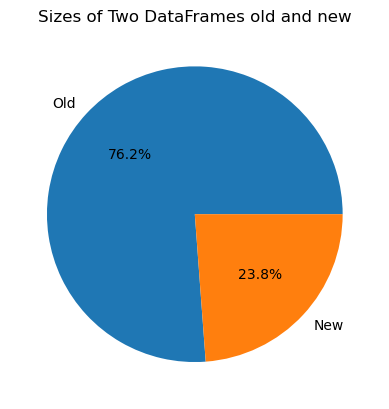

In [10]:
# Concatenate all the DataFrames into a single DataFrame
old = pd.concat(dfs_old, ignore_index=True)
new = pd.concat(dfs_new, ignore_index=True)

# calculate the sizes of each dataframe
sizes = [len(old), len(new)]

# create a pie chart
labels = ['Old', 'New']
plt.pie(sizes, labels=labels, autopct='%1.1f%%')
plt.title('Sizes of Two DataFrames old and new')
plt.show()

### 2.4.3 Processing old dataframe (1)
Applying special filter to the dataset from October 2010 to March 2020

In [11]:
old_org = old
if "_filter" not in old.columns:
    old.drop(["Start station", "End station"], axis=1)
    old.rename(columns={
        'Duration': 'duration', 
        'Start date': 'started_at', 
        'End date': 'ended_at', 
        'Start station number': 'start_station_id', 
        'End station number': 'end_station_id',
        'Member type': 'member_casual',
        'Start station': 'start_station_name',
        'End station': 'end_station_name',
        'Bike number': 'bike_number'
    }, inplace=True)
    old['_filter'] = 0

test = old.drop('_filter', axis=1).copy()
notunique = test[test.duplicated(subset=['started_at', 'ended_at', 'start_station_id', 'end_station_id'])]
print("Found", notunique['duration'].count(), "duplicates (" + str(round(notunique['duration'].count()/test["duration"].count()*100, 2)), "%)")
old.loc[notunique.index, '_filter'] = 1

old['started_at'] = pd.to_datetime(old['started_at'])
old['ended_at'] = pd.to_datetime(old['ended_at'])
old['date'] = old['started_at'].dt.date

# Member -> member / Casual -> casual
old.member_casual = old.member_casual.str.lower()

old.head(1)

Found 21742 duplicates (0.08 %)


,duration,started_at,ended_at,start_station_id,start_station_name,end_station_id,end_station_name,bike_number,member_casual,_filter,date
0,1012,2010-09-20 11:27:04,2010-09-20 11:43:56,31208,M St & New Jersey Ave SE,31108,4th & M St SW,W00742,member,0,2010-09-20


### 2.4.4 Processing old dataframe (2)
Applying special filter to the dataset from October 2010 to March 2020

In [12]:
# create a dictionary that maps each station ID to its latitude and longitude
station_locations = {}
for station_id in set(old['start_station_id']):
    station_locations[station_id] = getStationPosition(station_id)

# create 'latitude' and 'longitude' columns using the dictionary
old['start_lat'], old['start_lng'] = zip(*old['start_station_id'].map(station_locations))

station_locations = {}
for station_id in set(old['end_station_id']):
    station_locations[station_id] = getStationPosition(station_id)

# create 'latitude' and 'longitude' columns using the dictionary
old['end_lat'], old['end_lng'] = zip(*old['end_station_id'].map(station_locations))

old['distance'] = old.apply(lambda x: distance((x["start_lat"], x["start_lng"]), (x["end_lat"], x["end_lng"])), axis=1)
old['speed'] = old['distance'] / (old['duration'] / 3600)

old.head(1)

,duration,started_at,ended_at,start_station_id,start_station_name,end_station_id,end_station_name,bike_number,member_casual,_filter,date,start_lat,start_lng,end_lat,end_lng,distance,speed
0,1012,2010-09-20 11:27:04,2010-09-20 11:43:56,31208,M St & New Jersey Ave SE,31108,4th & M St SW,W00742,member,0,2010-09-20,38.8763,-77.0037,38.876697,-77.017898,1.229804,4.374796


### 2.4.5 Processing new dataframe (1)
Applying special filter to the dataset from April 2010

In [13]:
if "_filter" not in new.columns:
    #new.drop(['ride_id', 'rideable_type'], axis=1, inplace=True)

    new['_filter'] = 0
    new['started_at'] = pd.to_datetime(new['started_at'])
    new['ended_at'] = pd.to_datetime(new['ended_at'])
    new['date'] = pd.to_datetime(new['started_at'].dt.date)
    new['duration'] = (new['ended_at'] - new['started_at']).dt.total_seconds()

    new['distance'] = new.apply(lambda x: distance((x["start_lat"], x["start_lng"]), (x["end_lat"], x["end_lng"])), axis=1)
    new['speed'] = new['distance'] / (new['duration'] / 3600)

    # Whenever a negative durations occur during the night time than we check if the daylight saving was switching
    count = 0
    for idx in new[(new.duration < 0) & (new.ended_at.dt.hour == 1)].index:
        date = new.loc[idx]["ended_at"]
        date_new = date.tz_localize(pytz.timezone('US/Eastern'), ambiguous=True) + pd.DateOffset(hour=1)
        if date.dst() != date_new.dst():
            new.loc[idx, 'duration'] = new.loc[idx, 'duration'] + 3600
            count += 1
    if count > 0:
        print(f"Fixed {count} errors due to daylight switch")

new.drop(new[new['start_station_id'] == "MTL-ECO5-03"].index, inplace=True)

prev = new[new['_filter'] == 0].shape[0]
new['_filter'] = ((pd.to_numeric(new.start_lat, errors='coerce').isna()) | (new['_filter']==1)).astype(int)
print(f"Filtered {prev - new[new['_filter'] == 0].shape[0]} lines start_lat was empty")

prev = new[new['_filter'] == 0].shape[0]
new['_filter'] = ((pd.to_numeric(new.end_lat, errors='coerce').isna()) | (new['_filter']==1)).astype(int)
print(f"Filtered {prev - new[new['_filter'] == 0].shape[0]} lines end_lat was empty")

new['start_station_id'].fillna(value=0, inplace=True)
new['start_station_id'] = new['start_station_id'].astype(int)
new['end_station_id'].fillna(value=0, inplace=True)
new['end_station_id'] = new['end_station_id'].astype(int)

Fixed 115 errors due to daylight switch
Filtered 8 lines start_lat was empty
Filtered 17765 lines end_lat was empty


### 2.4.6 Processing new dataframe (2) - Durations
Check the new calcucated duration

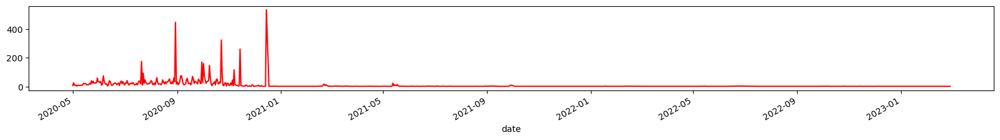

In [14]:
fig, axes = plt.subplots(1, 1, tight_layout=False, figsize = (20, 2))
g = new[(new._filter == 0) & (new.duration < 0)].groupby(['date'])["duration"].count().plot.line(color="red")


In [15]:
print("Count of total trips on 2020-12-15:", new[(new['date'] == "2020-12-15") ]["date"].count())
print("Count of trips with negative duration on 2020-12-15:", new[(new['date'] == "2020-12-15") & (new["duration"] < 0)]["date"].count())

print("Min/Max of started_at:", new[new["duration"] < -100000]["started_at"].min(), "/",  new[new["duration"] < -100000]["started_at"].max())
print("Min/Max of ended_at:", new[new["duration"] < -100000]["ended_at"].min(), "/",  new[new["duration"] < -100000]["ended_at"].max())

print("Count of trips at 2020-12-15:", new[new.date == "2020-12-15"]["date"].count())
print("Count of trips at 2020-11-25:", new[new.date == "2020-11-25"]["date"].count())

print("Count of trips within Min/Max of started_at:", new[(new.started_at >= "2020-12-15 12:34:42") & (new.started_at <= "2020-12-15 13:21:55")]["date"].count())
print("Count of trips within Min/Max of started_at with positive duration:", new[(new.started_at >= "2020-12-15 12:34:42") & (new.started_at <= "2020-12-15 13:21:55") & (new.duration > 0)]["date"].count())
print("Count of trips the previous week in the same time period:", new[(new.started_at >= "2020-12-08 12:34:42") & (new.started_at <= "2020-12-08 13:21:55")]["date"].count())
print("Count of trips the next week in the same time period:", new[(new.started_at >= "2020-12-22 12:34:42") & (new.started_at <= "2020-12-22 13:21:55")]["date"].count())

Count of total trips on 2020-12-15: 4106
Count of trips with negative duration on 2020-12-15: 535
Min/Max of started_at: 2020-12-15 12:34:42 / 2020-12-15 13:21:55
Min/Max of ended_at: 2020-11-25 08:42:10 / 2020-11-26 00:28:12
Count of trips at 2020-12-15: 4106
Count of trips at 2020-11-25: 4165
Count of trips within Min/Max of started_at: 758
Count of trips within Min/Max of started_at with positive duration: 223
Count of trips the previous week in the same time period: 162
Count of trips the next week in the same time period: 198


### 2.4.7 Processing new dataframe (3) - Durations
Plot a graph for the 2020-12-15 between 12:15 pm and 13:30 pm. Red is the count of trips per minute. Blue is the count of trips with positive duration per minute.

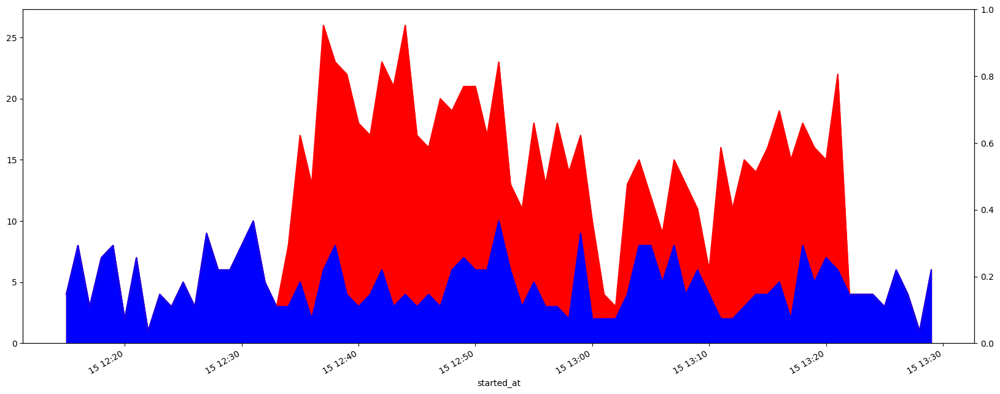

In [16]:
fig, axes = plt.subplots(1, 1, tight_layout=False, figsize = (20, 8))
g = new[(new.started_at >= "2020-12-15 12:15:00") & (new.started_at <= "2020-12-15 13:30:00")].groupby([new.started_at.dt.floor('Min')])["started_at"].count().plot.area(color="red")
g2 = new[(new.started_at >= "2020-12-15 12:15:00") & (new.started_at <= "2020-12-15 13:30:00") & (new.duration > 0)].groupby([new.started_at.dt.floor('Min')])["started_at"].count().plot.area(color="blue").plot(ax=g.twinx())


In [17]:
prev = new[new['_filter'] == 0].shape[0]
new['_filter'] = (((new.started_at >= "2020-12-15 12:00:00") & (new.started_at <= "2020-12-15 14:00:00") & (new.duration < 0)) | (new['_filter']==1)).astype(int)
print(f"Filtered {prev - new[new['_filter'] == 0].shape[0]} lines because duration < 0")

Filtered 535 lines because duration < 0


### 2.4.8 Combine both dataframes old and new

In [18]:
display(old.head(2))
display(new.head(2))

,duration,started_at,ended_at,start_station_id,start_station_name,end_station_id,end_station_name,bike_number,member_casual,_filter,date,start_lat,start_lng,end_lat,end_lng,distance,speed
0,1012,2010-09-20 11:27:04,2010-09-20 11:43:56,31208,M St & New Jersey Ave SE,31108,4th & M St SW,W00742,member,0,2010-09-20,38.8763,-77.0037,38.876697,-77.017898,1.229804,4.374796
1,61,2010-09-20 11:41:22,2010-09-20 11:42:23,31209,1st & N St SE,31209,1st & N St SE,W00032,member,0,2010-09-20,38.8743,-77.0057,38.874300,-77.005700,0.000000,0.000000


,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual,_filter,date,duration,distance,speed
0,77A0F1B26D1597B1,docked_bike,2020-04-25 17:28:39,2020-04-25 17:35:04,Rhode Island & Connecticut Ave NW,31239,12th & L St NW,31251,38.905996,-77.039802,38.903819,-77.028400,casual,0,2020-04-25,385.0,1.015884,9.499175
1,8698F10128EA4F18,docked_bike,2020-04-06 07:54:59,2020-04-06 07:57:24,21st & I St NW,31205,18th & L St NW,31224,38.900711,-77.046449,38.903741,-77.042452,member,0,2020-04-06,145.0,0.482884,11.988854


In [19]:
result = pd.concat([old, new], ignore_index=True)
result.shape

(34913987, 19)

### 2.5 Applying Filter

In [20]:
filters = {
    "member_casual": {'is': 'unknown'},
    "duration": {'>': 86400, '<': 60},
    "speed": {'>': 30},
    "start_lat": {'is': 0},
    "end_lat": {'is': 0}
}

for f in filters:
    for t in filters[f]:
        v = filters[f][t]
        prev = result[result['_filter'] == 0].shape[0]
        result.loc[((t == '>' and result[f] > v) | (t == '<' and result[f] < v) | (t == 'is' and result[f] == v)), '_filter'] = 1
        print(f"Filtered {prev - result[result['_filter'] == 0].shape[0]} lines because {f} {t} '{v}'")


Filtered 58 lines because member_casual is 'unknown'
Filtered 5029 lines because duration > '86400'
Filtered 121782 lines because duration < '60'
Filtered 17438 lines because speed > '30'
Filtered 0 lines because start_lat is '0'
Filtered 13 lines because end_lat is '0'


### 2.6 Applying special filter

In [21]:
prev = result[result['_filter'] == 0].shape[0]
result['_filter'] = (((result['duration'] < 300) & (result.start_station_id == result.end_station_id)) | (result['_filter'] == 1)).astype(int)
print(f"Filtered {prev - result[result['_filter'] == 0].shape[0]} lines because duration < 300 and start_station_id == end_station_id")

Filtered 221034 lines because duration < 300 and start_station_id == end_station_id


In [22]:
print(f"A total of {result[result._filter == 1].shape[0]} of {result.shape[0]} lines ({round(result[result._filter == 1].shape[0] / result.shape[0] * 100 , 2)}%) were filtered")

A total of 405404 of 34913987 lines (1.16%) were filtered


## 3 Findings

### 3.1 Amounts of available stations

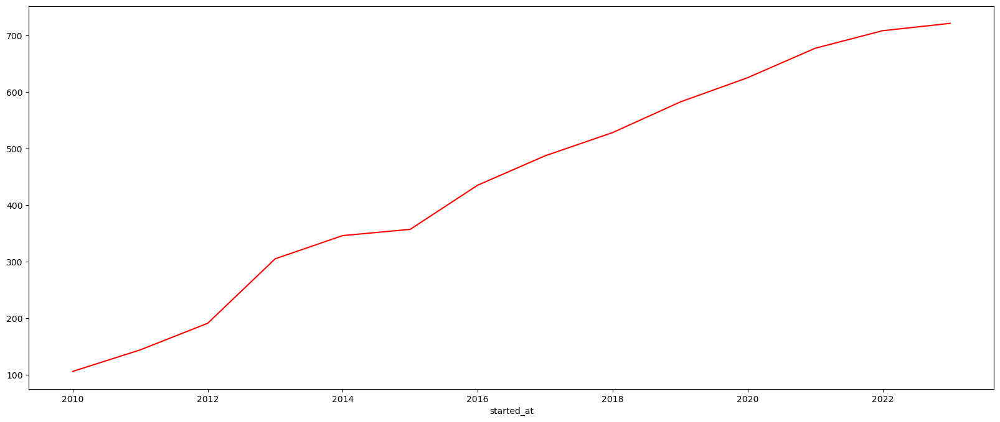

In [23]:
fig, axes = plt.subplots(1, 1, tight_layout=False, figsize = (20, 8))
g = result[(result['_filter'] == 0)].groupby([result.started_at.dt.year])['start_station_id'].nunique().plot.line(color="red")


### 3.2.1 Which stations have the largest differences between in- and outbound

In [24]:
from collections import defaultdict

test = defaultdict(list)
for g in result[result._filter==0].groupby(['start_station_name']):
    test[g[0]] = {'in': len(g[1]['end_lng']), 'out': 0, 'lat': (g[1]['start_lat'].values[0]), 'lng': (g[1]['start_lng'].values[0])}

for g in result[result._filter==0].groupby(['end_station_name']):
    if g[0] in test:
        test[g[0]]['out'] = len(g[1]['end_lng'])
    else:
        test[g[0]] = {'in': 0, 'out': len(g[1]['end_lng']), 'lat': (g[1]['start_lat'].values[0]), 'lng': (g[1]['start_lng'].values[0])}

for k, v in test.items():
    v['diff'] = v['in'] - v['out']

testDF = pd.DataFrame(test)
testDF2 = testDF.transpose()
display(testDF2.nsmallest(5, 'diff'))
display(testDF2.nlargest(5, 'diff'))


,in,out,lat,lng,diff
Georgetown Harbor / 30th St NW,156374.0,227137.0,38.902314,-77.059141,-70763.0
Massachusetts Ave & Dupont Circle NW,518712.0,584015.0,38.910100,-77.044400,-65303.0
C & O Canal & Wisconsin Ave NW,161904.0,214350.0,38.903750,-77.062690,-52446.0
M St & Pennsylvania Ave NW,208118.0,252149.0,38.905126,-77.056887,-44031.0
13th St & New York Ave NW,147690.0,191682.0,38.900283,-77.029822,-43992.0


,in,out,lat,lng,diff
16th & Harvard St NW,229028.0,119769.0,38.926088,-77.036536,109259.0
14th & Harvard St NW,159908.0,103131.0,38.926800,-77.032200,56777.0
Columbia Rd & Belmont St NW,145388.0,92773.0,38.920669,-77.043680,52615.0
14th & Irving St NW,149471.0,97561.0,38.928552,-77.032224,51910.0
11th & Kenyon St NW,186585.0,136585.0,38.929464,-77.027822,50000.0


In [25]:
fig = px.density_mapbox(testDF2.nlargest(10, 'diff'), lat='lat', lon='lng', z='diff', mapbox_style="stamen-terrain", width=1500, height=600, zoom=14, radius=35)
# fig = px.density_mapbox(testDF2.nsmallest(10, 'diff'), lat='lat', lon='lng', z='diff', mapbox_style="stamen-terrain", width=1500, height=1000, zoom=12, radius=35)
fig

In [26]:
fig = px.density_mapbox(testDF2.nsmallest(10, 'diff'), lat='lat', lon='lng', z='diff', mapbox_style="stamen-terrain", width=1500, height=600, zoom=14, radius=35)
# fig = px.density_mapbox(testDF2.nsmallest(10, 'diff'), lat='lat', lon='lng', z='diff', mapbox_style="stamen-terrain", width=1500, height=1000, zoom=12, radius=35)
fig

### 3.3.1 Dockless bikes (1)

In [27]:
# Round the latitude values to two decimal places
result_rounded = result[result['_filter']==0]["end_lat"].round(2)

# Create a Boolean mask to identify rows with latitude values with two decimals
mask = result[result['_filter']==0]["end_lat"] == result_rounded

# Select only the rows with latitude values with two decimals
result_with_two_decimals = result[result['_filter']==0][mask]

result_with_two_decimals.head()


,duration,started_at,ended_at,start_station_id,start_station_name,end_station_id,end_station_name,bike_number,member_casual,_filter,date,start_lat,start_lng,end_lat,end_lng,distance,speed,ride_id,rideable_type
26879734,374.0,2020-06-17 16:18:05,2020-06-17 16:24:19,31408,Takoma Metro,0,NaN,NaN,member,0,2020-06-17 00:00:00,38.975203,-77.016858,38.96,-77.01,1.791420,17.243619,CBF2C8B6BC3F85F5,electric_bike
26886181,109.0,2020-06-18 16:24:35,2020-06-18 16:26:24,32061,New Hampshire & Kirklynn Ave,0,NaN,NaN,member,0,2020-06-18 00:00:00,38.988120,-76.988491,38.99,-76.99,0.246440,8.139311,1CEAD268FA07C56C,electric_bike
26886182,289.0,2020-06-18 16:28:53,2020-06-18 16:33:42,32061,New Hampshire & Kirklynn Ave,0,NaN,NaN,member,0,2020-06-18 00:00:00,38.988110,-76.988371,38.99,-76.99,0.252929,3.150667,E3EEEDDDB997CDE2,electric_bike
26897681,469.0,2020-06-29 15:18:15,2020-06-29 15:26:04,0,NaN,0,NaN,NaN,member,0,2020-06-29 00:00:00,38.970000,-77.020000,38.96,-77.01,1.408517,10.811643,C16380A33FBAA384,electric_bike
26897752,1247.0,2020-06-18 15:48:06,2020-06-18 16:08:53,0,NaN,0,NaN,NaN,casual,0,2020-06-18 00:00:00,38.960000,-77.010000,38.99,-76.99,3.757258,10.846937,90C58FF03B4B5CE8,electric_bike


### 3.3.2 Dockless bikes (2)
When were the first travel with a dockless bike?

In [28]:
result_with_two_decimals.nsmallest(1,'started_at')

,duration,started_at,ended_at,start_station_id,start_station_name,end_station_id,end_station_name,bike_number,member_casual,_filter,date,start_lat,start_lng,end_lat,end_lng,distance,speed,ride_id,rideable_type
26897831,315.0,2020-06-17 14:24:43,2020-06-17 14:29:58,0,NaN,0,NaN,NaN,member,0,2020-06-17 00:00:00,38.96,-77.01,38.97,-77.02,1.408517,16.097335,9BAB41D119E2B048,electric_bike


In [29]:
result_with_two_decimals.groupby('rideable_type')['rideable_type'].count().to_dict()

{'classic_bike': 6990, 'electric_bike': 398205}

In [30]:
display(result_with_two_decimals[result_with_two_decimals.rideable_type =="classic_bike"].nsmallest(1,'started_at'))
display(result_with_two_decimals[result_with_two_decimals.rideable_type =="electric_bike"].nsmallest(1,'started_at'))

,duration,started_at,ended_at,start_station_id,start_station_name,end_station_id,end_station_name,bike_number,member_casual,_filter,date,start_lat,start_lng,end_lat,end_lng,distance,speed,ride_id,rideable_type
28223760,1480.0,2020-12-09 17:20:20,2020-12-09 17:45:00,31507,1st & Washington Hospital Center NW,0,NaN,NaN,casual,0,2020-12-09 00:00:00,38.928743,-77.012457,38.93,-77.06,4.114886,10.009182,49528C6AA7E02B32,classic_bike


,duration,started_at,ended_at,start_station_id,start_station_name,end_station_id,end_station_name,bike_number,member_casual,_filter,date,start_lat,start_lng,end_lat,end_lng,distance,speed,ride_id,rideable_type
26897831,315.0,2020-06-17 14:24:43,2020-06-17 14:29:58,0,NaN,0,NaN,NaN,member,0,2020-06-17 00:00:00,38.96,-77.01,38.97,-77.02,1.408517,16.097335,9BAB41D119E2B048,electric_bike


### 3.3.3 Dockless bikes (3)
When were dockless bikes used?

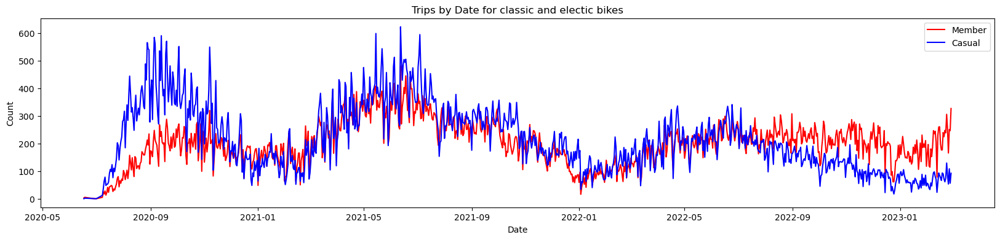

In [31]:
plt.figure(figsize=(20, 4))
sns.lineplot(data=result_with_two_decimals[result_with_two_decimals.member_casual == "member"].groupby([result.started_at.dt.date])["date"].count(), color="Red", label="Member" )
sns.lineplot(data=result_with_two_decimals[result_with_two_decimals.member_casual != "member"].groupby([result.started_at.dt.date])["date"].count(), color="Blue", label="Casual" )
plt.title('Trips by Date for classic and electic bikes'); plt.xlabel('Date'); plt.ylabel('Count'); plt.show()

### 3.4 Longest travel

In [32]:
result[(result._filter == 0) & (result.distance == result[result._filter == 0].distance.max())]

,duration,started_at,ended_at,start_station_id,start_station_name,end_station_id,end_station_name,bike_number,member_casual,_filter,date,start_lat,start_lng,end_lat,end_lng,distance,speed,ride_id,rideable_type
28999570,11697.0,2021-05-05 15:21:27,2021-05-05 18:36:24,0,NaN,0,NaN,NaN,member,0,2021-05-05 00:00:00,38.9,-77.0,38.44,-76.86,52.573877,16.180726,31B8038FC502E043,electric_bike


In [33]:
trip = result.loc[28999570]
m = folium.Map(location=[statistics.mean([trip['start_lat'], trip['end_lat']]), statistics.mean([trip['start_lng'], trip['end_lng']])])
folium.PolyLine(locations=[(trip['start_lat'], trip['start_lng']), (trip['end_lat'], trip['end_lng'])], weight=5).add_to(m)
m.fit_bounds(m.get_bounds())
fig = folium.Figure(2000, 600)
fig.add_child(m)
m # Show the map


### 3.5 Which bike was used the most?

In [34]:
result[(result._filter==0) & (result["bike_number"] != "NaN" )].groupby("bike_number")["duration"].count().sort_values().tail(3)

bike_number
W00068    9751
W01039    9772
W00494    9778
Name: duration, dtype: int64

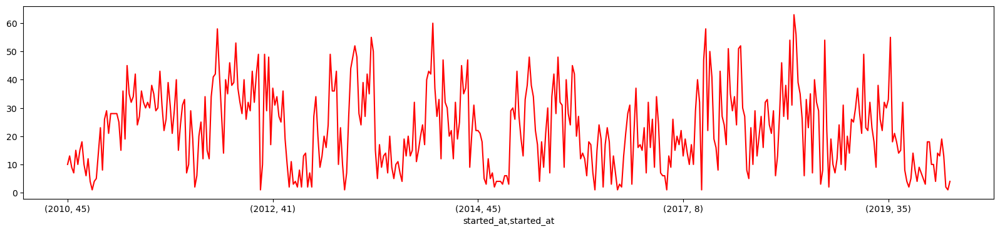

In [35]:
fig, axes = plt.subplots(1, 1, tight_layout=False, figsize = (20, 4))
g = result[(result._filter==0) & (result["bike_number"] == "W00494" )].groupby([result.started_at.dt.year, result.started_at.dt.weekofyear])["date"].count().plot.line(color="red")

### 3.6 Most trips per day and bike

In [36]:
df = result[(result._filter==0) & (result["bike_number"] == "W00067") & (result['started_at'] >= '2011-02-22 00:00:00') & (result['started_at'] <= '2011-02-22 23:59:59')].sort_values(
    by='started_at')[['start_lat', 'start_lng', 'end_lat', 'end_lng', 'speed']]

# Extract the start and end latitude and longitude values from the DataFrame
start_latitudes = df['start_lat'].tolist()
start_longitudes = df['start_lng'].tolist()

# Create a folium map centered on the first start location
m = folium.Map(location=[statistics.mean(start_latitudes), statistics.mean(start_longitudes)])
pairs_list = list(zip(start_latitudes, start_longitudes))

# Add a polyline to the map using the locations_list
folium.PolyLine(locations=pairs_list, weight=5).add_to(m)
m.fit_bounds(m.get_bounds())
fig = folium.Figure(2000, 600)
fig.add_child(m)
m # Show the map

In [37]:
result[(result._filter==0) & (result["bike_number"] == "W00067") & (result['started_at'] >= '2011-02-22 00:00:00') & (result['started_at'] <= '2011-02-22 23:59:59')]['duration'].sum()/(3600)

13.87

### 3.7 New rideable type electric bike
<!--Capital bike offered electric bikes early on but had to take them off the streets due to safety issues with the brakes. Beginning of 2020-06-17 the new ebikes were rolled out.-->

In [38]:
result[(result._filter==0) & (result.rideable_type == 'electric_bike')].nsmallest(1,'started_at')['started_at'].to_dict()

{26897831: Timestamp('2020-06-17 14:24:43')}

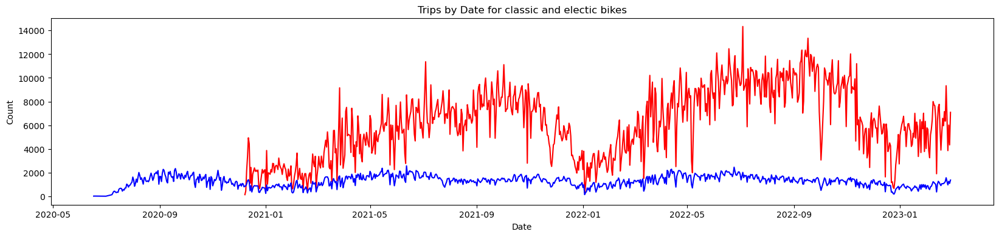

In [39]:
plt.figure(figsize=(20, 4))
sns.lineplot(data=result[(result._filter==0) & (result.rideable_type == 'classic_bike') ].groupby([result.started_at.dt.date])["date"].count(), color="Red")
sns.lineplot(data=result[(result._filter==0) & (result.rideable_type == 'electric_bike')].groupby([result.started_at.dt.date])["date"].count(), color="Blue")
plt.title('Trips by Date for classic and electic bikes'); plt.xlabel('Date'); plt.ylabel('Count'); plt.show()

### 3.8 Member vs Casual
Corona made a big dent into 

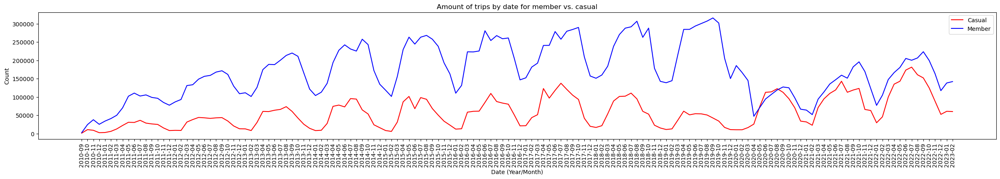

In [40]:
plt.figure(figsize=(30, 4))
sns.lineplot(data=result[(result._filter==0) & (result.member_casual == 'casual') ].groupby([result['started_at'].dt.year.astype(str) + '-' + result['started_at'].dt.month.astype(str).str.zfill(2)])["date"].count(), color="Red", label="Casual")
sns.lineplot(data=result[(result._filter==0) & (result.member_casual != 'casual')].groupby([result['started_at'].dt.year.astype(str) + '-' + result['started_at'].dt.month.astype(str).str.zfill(2)])["date"].count(), color="Blue", label="Member")
plt.title('Amount of trips by date for member vs. casual'); plt.xlabel('Date (Year/Month)'); plt.ylabel('Count'); plt.xticks(rotation=90); plt.show()

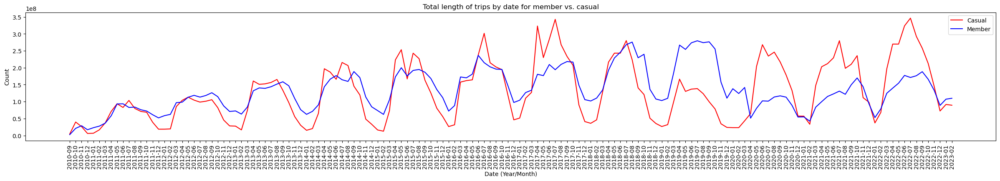

In [41]:
plt.figure(figsize=(30, 4))
sns.lineplot(data=result[(result._filter==0) & (result.member_casual == 'casual') ].groupby([result['started_at'].dt.year.astype(str) + '-' + result['started_at'].dt.month.astype(str).str.zfill(2)])["duration"].sum(), color="Red", label="Casual")
sns.lineplot(data=result[(result._filter==0) & (result.member_casual != 'casual')].groupby([result['started_at'].dt.year.astype(str) + '-' + result['started_at'].dt.month.astype(str).str.zfill(2)])["duration"].sum(), color="Blue", label="Member")
plt.title('Total length of trips by date for member vs. casual'); plt.xlabel('Date (Year/Month)'); plt.ylabel('Count'); plt.xticks(rotation=90); plt.show()

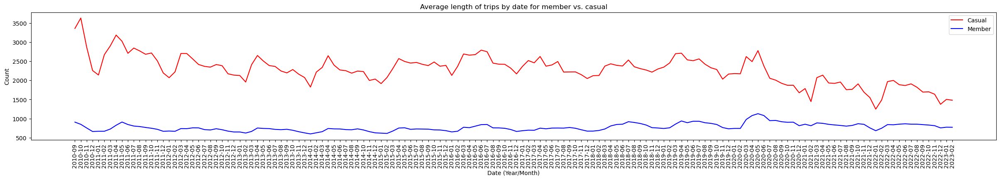

In [42]:
plt.figure(figsize=(30, 4))
sns.lineplot(data=result[(result._filter==0) & (result.member_casual == 'casual') ].groupby([result['started_at'].dt.year.astype(str) + '-' + result['started_at'].dt.month.astype(str).str.zfill(2)])["duration"].mean(), color="Red", label="Casual")
sns.lineplot(data=result[(result._filter==0) & (result.member_casual != 'casual')].groupby([result['started_at'].dt.year.astype(str) + '-' + result['started_at'].dt.month.astype(str).str.zfill(2)])["duration"].mean(), color="Blue", label="Member")
plt.title('Average length of trips by date for member vs. casual'); plt.xlabel('Date (Year/Month)'); plt.ylabel('Count'); plt.xticks(rotation=90); plt.show()

## 4 Generate Output
Can we create a Datafile that is similar to the data provided from UCI for machine learning?

### 4.1 Grouping by date, hour and member_type

In [43]:
test = result[(result.started_at > "2011-01-01 00:00:00")].groupby([result.date, result.started_at.dt.hour, result.member_casual])["start_station_id"].count().reset_index()

# # Rename the columns
test.columns = ['date', 'started_at', 'member_casual', 'count']

# Pivot the table to get the desired output
pivot_df = pd.pivot_table(test, index=['date', 'started_at'], columns='member_casual', values='count', aggfunc=sum)
pivot_df = pivot_df.fillna(0)

# Add a column for the total count
pivot_df['total'] = pivot_df['casual'] + pivot_df['member']

# Reset the index and convert it to the desired format
output_df = pivot_df.reset_index()#.rename(columns={'Casual': 'casual', 'Member': 'member'})
output_df = output_df[['date', 'started_at', 'casual', 'member', 'total']]
output_df.columns = ['dteday', 'hr', 'casual', 'registered', 'cnt']

output_df['dteday'] = pd.to_datetime(output_df['dteday'])
output_df['hr'] = pd.to_numeric(output_df['hr'].astype("int"))
output_df['casual'] = pd.to_numeric(output_df['casual'].astype("int"))
output_df['registered'] = pd.to_numeric(output_df['registered'].astype("int"))
output_df['cnt'] = pd.to_numeric(output_df['cnt'].astype("int"))
output_df.head()


,dteday,hr,casual,registered,cnt
0,2011-01-01,0,3,13,16
1,2011-01-01,1,8,30,38
2,2011-01-01,2,5,26,31
3,2011-01-01,3,3,9,12
4,2011-01-01,4,0,1,1


### 4.2 Compare it with data from the UCI

In [44]:
df = pd.read_csv("../data/hour.csv")
display(df[['dteday', 'hr', 'casual', 'registered', 'cnt']].head(2))
display(output_df.head(2))

,dteday,hr,casual,registered,cnt
0,2011-01-01,0,3,13,16
1,2011-01-01,1,8,32,40


,dteday,hr,casual,registered,cnt
0,2011-01-01,0,3,13,16
1,2011-01-01,1,8,30,38


Did we filter to much data? Let's check the original data to be sure:
<blockquote>zcat 2011-capitalbikeshare-tripdata.zip | grep '^"[0-9][0-9]*","2011-01-01 01:' | cut -d "," -f 9 | sort | uniq -c<br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp; 8 "Casual"<br/>
&nbsp;&nbsp;&nbsp;&nbsp;30 "Member"</blockquote>
Looks like the basis of the data provided by UCI is something else!

### 4.3 Check for missing days
I tried to match our new dataframe with a dataframe with weather information but python complained that there had different sizes

In [45]:
# Convert the 'date' column to a pandas datetime object
df = pd.DataFrame()
df['date'] = result.sort_values("date")['date'].unique()

# Set the 'date' column as the index
df.set_index('date', inplace=True)

# # Resample the DataFrame to a daily time series with a frequency of one day
# daily_df = df.resample('1D').count()
    
print(pd.date_range(start = result.date.min(), end = result.date.max() ).difference(df.index))


DatetimeIndex(['2016-01-23', '2016-01-24', '2016-01-25', '2016-01-26'], dtype='datetime64[ns]', freq=None)


In [46]:
result[(result.started_at >= "2016-01-22 19") & (result.started_at <= "2016-01-27 16")].sort_values("date").tail()

,duration,started_at,ended_at,start_station_id,start_station_name,end_station_id,end_station_name,bike_number,member_casual,_filter,date,start_lat,start_lng,end_lat,end_lng,distance,speed,ride_id,rideable_type
12137199,418.0,2016-01-27 15:43:58,2016-01-27 15:50:57,31231,14th & D St NW / Ronald Reagan Building,31633,Independence Ave & L'Enfant Plaza SW/DOE,W01376,member,0,2016-01-27,38.894514,-77.031617,38.887312,-77.025762,0.947684,8.161870,NaN,NaN
12137200,390.0,2016-01-27 15:46:10,2016-01-27 15:52:40,31242,18th St & Pennsylvania Ave NW,31228,8th & H St NW,W01224,member,0,2016-01-27,38.899680,-77.041539,38.899700,-77.023086,1.596870,14.740339,NaN,NaN
12137201,183.0,2016-01-27 15:47:06,2016-01-27 15:50:09,31227,13th St & New York Ave NW,31231,14th & D St NW / Ronald Reagan Building,W21357,member,0,2016-01-27,38.900283,-77.029822,38.894514,-77.031617,0.660024,12.984074,NaN,NaN


### 4.4 Check for missing hours
What else might be missing? I exported the hourly grouped dataset as csv file and did some fast comparison in the command line
<blockquote>cat day.diff | wc -l<br/>
530</blockquote>

<div id="test">
<img src="output1.png" alt="" /> 
</div>

# 5 Recommendations

### 5.1 Recommendations
<blockquote><h2>Fix missing values</h2>
We have to build up a regession ML model to fix the missing values for "casual", "registered" and "cnt"</blockquote>

<blockquote><h2>Normalisation</h2>
Some fields in the original data was normalized (i.e. "temp", "atemp", "windspeed"). Since we have new min and max values it has to be decided how to code the data.</blockquote>

<blockquote><h2>Find a relialable weather source</h2> 
The historical weather data doens't contain "cloudy" or "foggy" weather - at least it is not yet fully understood how the information might be coded.</blockquote>

# 6 Appendix

### 6.1 Sources
https://en.wikipedia.org/wiki/Capital_Bikeshare
https://en.wikipedia.org/wiki/Washington,_D.C.#Infrastructure
https://en.wikipedia.org/wiki/Transportation_in_Washington,_D.C.

https://opendata.dc.gov/datasets/DCGIS::capital-bikeshare-locations/explore?location=38.953875%2C-77.097127%2C11.86
https://opendata.dc.gov/datasets/DCGIS::bicycle-lanes/explore?location=38.898559%2C-77.003831%2C13.01
https://opendata.dc.gov/datasets/DCGIS::shuttle-bus-stops/explore?location=38.917765%2C-77.035699%2C13.91
https://opendata.dc.gov/datasets/DCGIS::metro-stations-in-dc/explore?location=38.889145%2C-77.018939%2C12.59

https://nacto.org/wp-content/uploads/2011/03/District-of-Columbia-Bicycle-Master-Plan-2005.pdf
https://ddot.dc.gov/sites/default/files/dc/sites/ddot/page_content/attachments/23397_Capital_Bikeshare_Plan_Update_v4_051220_WEB.pdf
https://ddot.dc.gov/sites/default/files/dc/sites/ddot/publication/attachments/Dockless%20Demonstration%20Evaluation%2012-17-18_FINAL.pdf

### 6.2. Thank you for the attention!
Here are some Haikus from ChatGPT as a gift :-)
<blockquote>Gathering info<br/>
But sometimes things just don't go<br/>
Data's a no-show</blockquote>

<blockquote>Big data in play<br/>
But sometimes leads us astray<br/>
Errors sneak away</blockquote>

<blockquote>Imperfect data<br/>
Garbage in, garbage out, say<br/>
Oops, we're in dismay</blockquote>

<blockquote>Numbers can deceive<br/>
Errors we just can't perceive<br/>
Oops, data's make-believe</blockquote>

# TEST

In [47]:
import geopandas as gpd
import pandas as pd
from shapely.geometry import Point

In [48]:
dc_wards = gpd.read_file("../Neighborhood_Clusters.shp")


In [49]:
dc_wards.head()

,geometry
0,"POLYGON ((-77.02829 38.98608, -77.02662 38.984..."
1,"POLYGON ((-77.04391 38.98432, -77.04370 38.984..."
2,"POLYGON ((-77.05530 38.95900, -77.05554 38.958..."
3,"POLYGON ((-77.01418 38.97237, -77.01432 38.972..."
4,"POLYGON ((-77.03286 38.97800, -77.03198 38.978..."


In [50]:
# Convert the point data to a GeoDataFrame
geometry = [Point(xy) for xy in zip(result.start_lng, result.start_lat)]
points_gdf = gpd.GeoDataFrame(result, geometry=geometry)

In [51]:
points_with_wards = gpd.sjoin(points_gdf, dc_wards, op="within")

In [52]:
points_with_wards[points_with_wards._filter==0].describe()

,duration,start_station_id,end_station_id,_filter,start_lat,start_lng,end_lat,end_lng,distance,speed,index_right
count,3.080061e+07,3.080061e+07,3.080061e+07,30800607.0,3.080061e+07,3.080061e+07,3.080061e+07,3.080061e+07,3.080061e+07,3.080061e+07,3.080061e+07
mean,1.128130e+03,3.100064e+04,3.097545e+04,0.0,3.890429e+01,-7.702753e+01,3.890286e+01,-7.702769e+01,1.811318e+00,8.823890e+00,2.893905e+01
std,2.151458e+03,3.193312e+03,3.316542e+03,0.0,1.569478e-02,2.038090e-02,1.575875e-02,2.083291e-02,1.231824e+00,4.475114e+00,8.090287e+00
min,6.000000e+01,0.000000e+00,0.000000e+00,0.0,3.881000e+01,-7.711000e+01,3.844000e+01,-7.736842e+01,0.000000e+00,-9.110903e+03,0.000000e+00
25%,4.200000e+02,3.121400e+04,3.121400e+04,0.0,3.889476e+01,-7.704157e+01,3.889447e+01,-7.704178e+01,9.468460e-01,6.462797e+00,2.200000e+01
50%,7.030000e+02,3.125500e+04,3.125100e+04,0.0,3.890276e+01,-7.703162e+01,3.890200e+01,-7.703150e+01,1.538657e+00,9.241195e+00,3.000000e+01
75%,1.181000e+03,3.150700e+04,3.150900e+04,0.0,3.891272e+01,-7.701536e+01,3.891010e+01,-7.701529e+01,2.404439e+00,1.152549e+01,3.600000e+01
max,8.639600e+04,3.290100e+04,3.290600e+04,0.0,3.899000e+01,-7.691351e+01,3.916000e+01,-7.680000e+01,5.257388e+01,2.999378e+01,4.500000e+01


In [53]:
result[result._filter==0].describe()

,duration,start_station_id,end_station_id,_filter,start_lat,start_lng,end_lat,end_lng,distance,speed
count,3.450858e+07,3.450858e+07,3.450858e+07,34508583.0,3.450858e+07,3.450858e+07,3.450858e+07,3.450858e+07,3.450858e+07,3.450858e+07
mean,1.140388e+03,3.098412e+04,3.095659e+04,0.0,3.890229e+01,-7.703292e+01,3.890109e+01,-7.703242e+01,1.830625e+00,8.855009e+00
std,2.210268e+03,3.253252e+03,3.384920e+03,0.0,2.478775e-02,2.900073e-02,2.423620e-02,2.853138e-02,1.339362e+00,4.527953e+00
min,6.000000e+01,0.000000e+00,0.000000e+00,0.0,3.877000e+01,-7.740000e+01,3.844000e+01,-7.756000e+01,0.000000e+00,-9.110903e+03
25%,4.110000e+02,3.120200e+04,3.120300e+04,0.0,3.889050e+01,-7.704478e+01,3.889050e+01,-7.704478e+01,9.213883e-01,6.479260e+00
50%,6.990000e+02,3.124800e+04,3.124800e+04,0.0,3.890114e+01,-7.703230e+01,3.890071e+01,-7.703228e+01,1.522110e+00,9.278773e+00
75%,1.195000e+03,3.150600e+04,3.150600e+04,0.0,3.891264e+01,-7.701767e+01,3.891010e+01,-7.701766e+01,2.419300e+00,1.158798e+01
max,8.639600e+04,3.290100e+04,3.290600e+04,0.0,3.913000e+01,-7.682000e+01,3.946000e+01,-7.663000e+01,5.257388e+01,2.999911e+01


In [54]:
# Define the number of groups
num_groups = 50

# Generate a list of evenly spaced numbers between 0 and 1
color_nums = np.linspace(0, 1, num_groups)

# Convert the numbers to RGB color codes using the colormap 'rainbow'
colors = plt.cm.rainbow(color_nums)

(-77.04, 38.99) 17.196056955093102 157 913
(-77.03681883333333, 38.98885283333333) 0.10952902519167579 1 913
(-77.03663433333334, 38.98890016666667) 0.10952902519167579 1 913
(-77.03662833333334, 38.988879) 0.10952902519167579 1 913
(-77.03661033333333, 38.98887483333333) 0.10952902519167579 1 913
(-77.0365735, 38.9888255) 0.10952902519167579 1 913
(-77.03, 38.98) 78.09419496166484 713 913
(-77.02951266666666, 38.986991833333335) 0.10952902519167579 1 913
(-77.02949533333333, 38.98701316666666) 0.10952902519167579 1 913
(-77.029472, 38.98696933333333) 0.10952902519167579 1 913
(-77.02945533333333, 38.98698266666667) 0.10952902519167579 1 913
(-77.02945233333334, 38.986981166666666) 0.10952902519167579 1 913
(-77.029452, 38.98696966666667) 0.10952902519167579 1 913
(-77.029451, 38.98695816666667) 0.10952902519167579 1 913
(-77.02945016666666, 38.986978666666666) 0.10952902519167579 1 913
(-77.02944916666667, 38.9869685) 0.10952902519167579 1 913
(-77.02944883333333, 38.9869765) 0.109529

KeyboardInterrupt: 

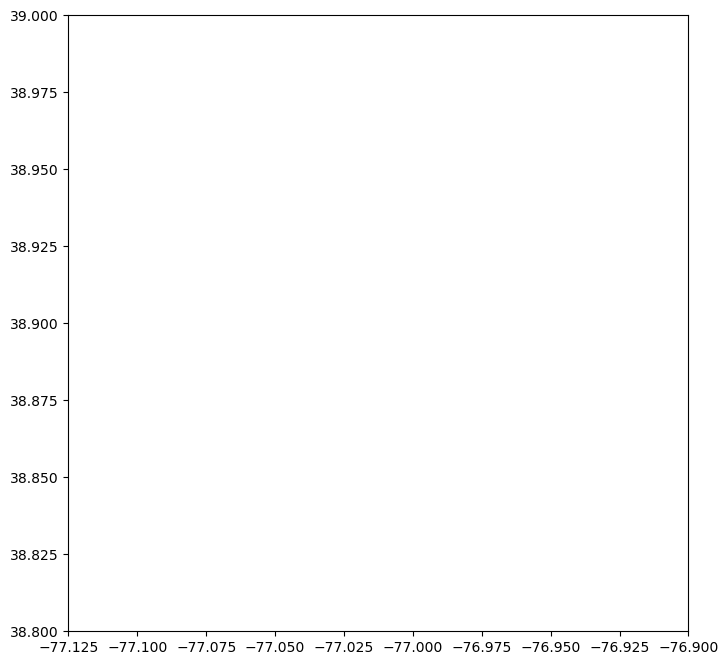

In [56]:
plt.figure(figsize=(8, 8))
plt.axis([-77.125, -76.9, 38.8, 39])
for x in points_with_wards.groupby("index_right"):
    total = x[1].shape[0]
    #print(x[0], total)#
    # ((-77.0081115, 38.875586166666665),           dura
    for z in x[1].groupby(["start_lng", "start_lat"]):
        c = z[1].shape[0]
        s = (c/total*100)
        plt.scatter(z[0][1], z[0][1], s=(c/total*100), color=colors[x[0]])

        print(z[0], s, c, total)
    #     break
    
# Display the plot

plt.show()

0


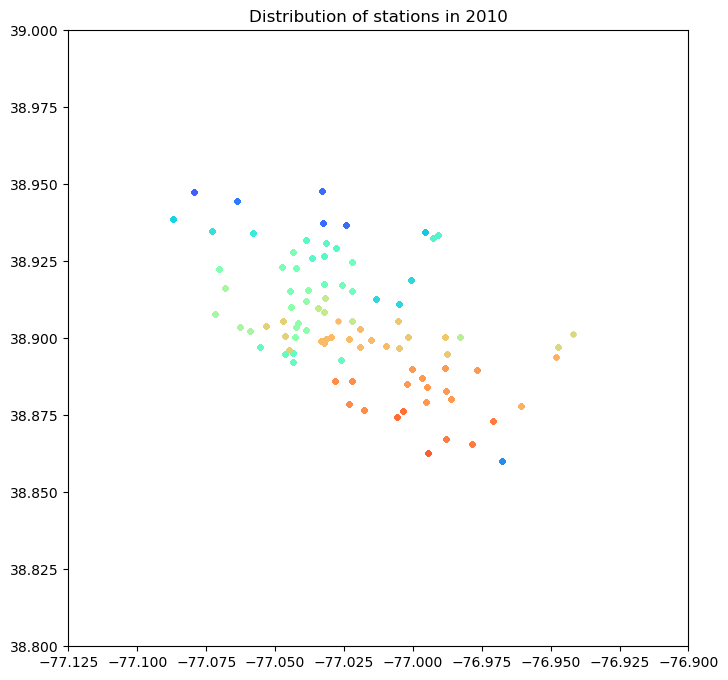

1


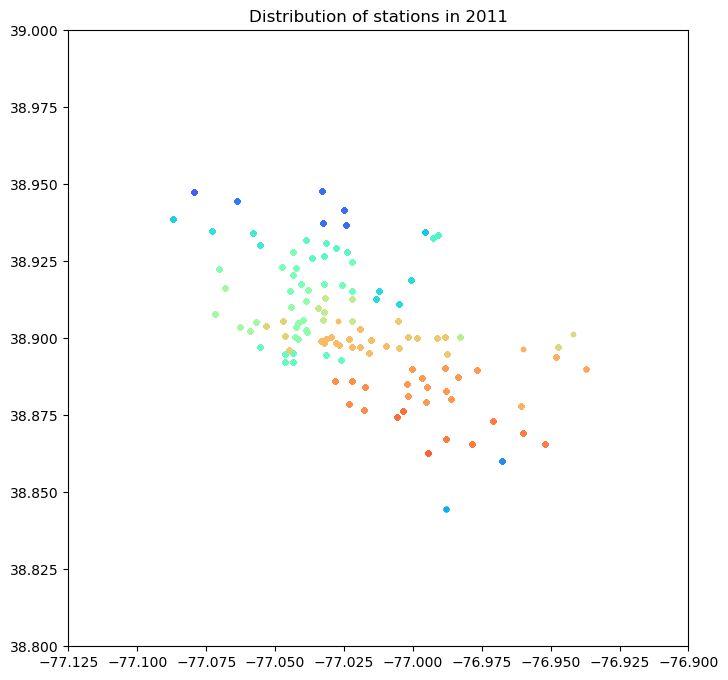

2


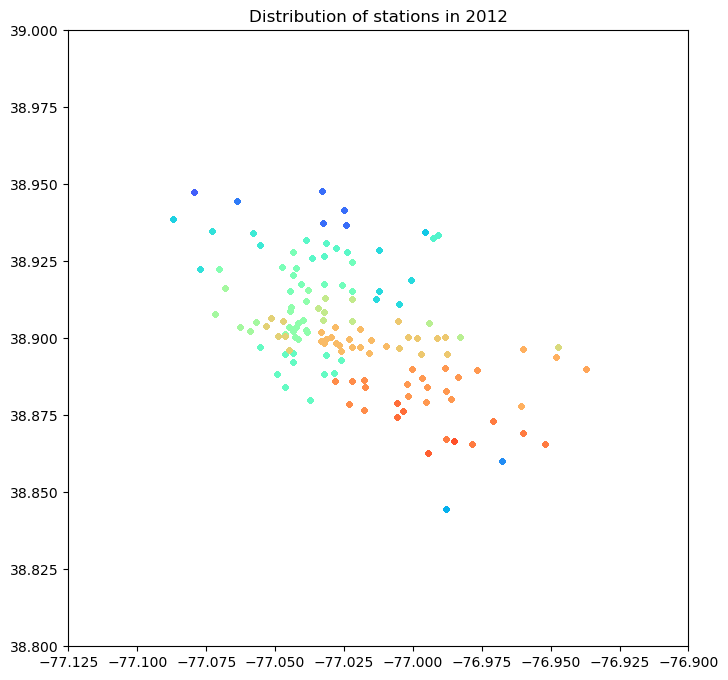

3


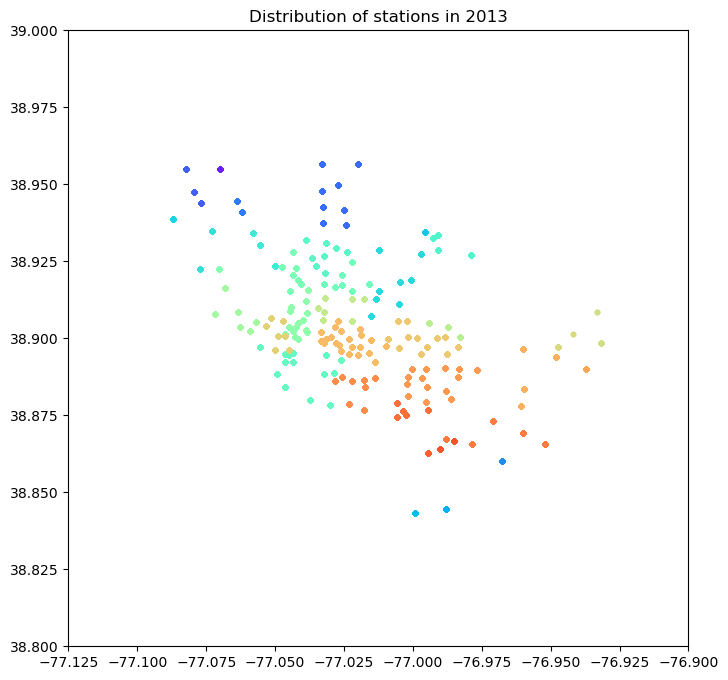

4


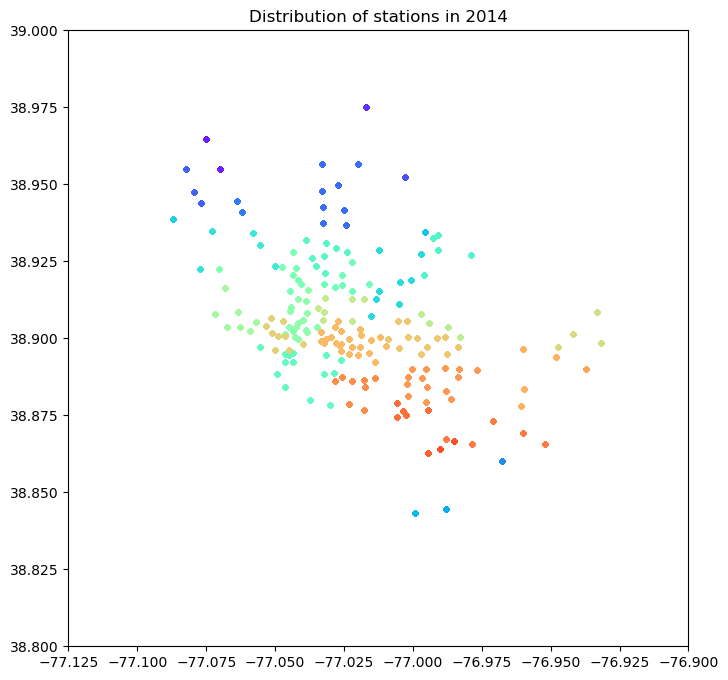

5


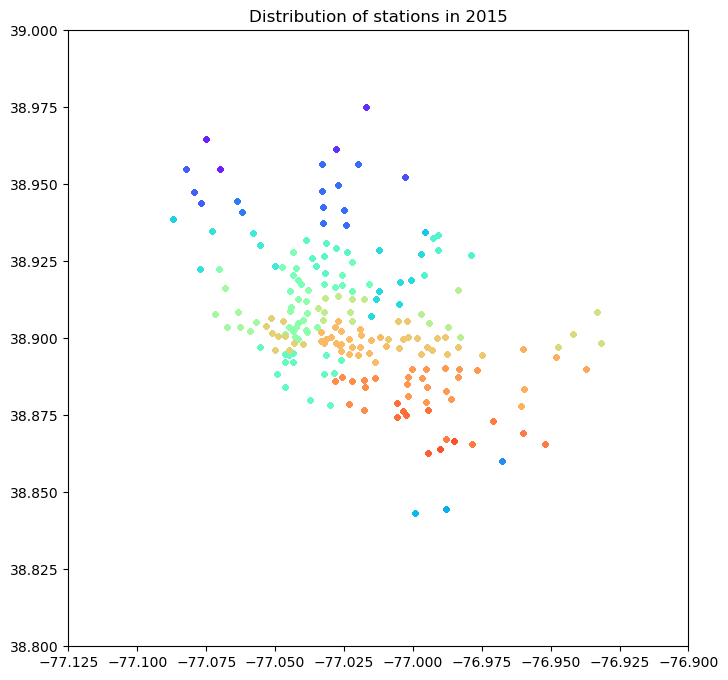

6


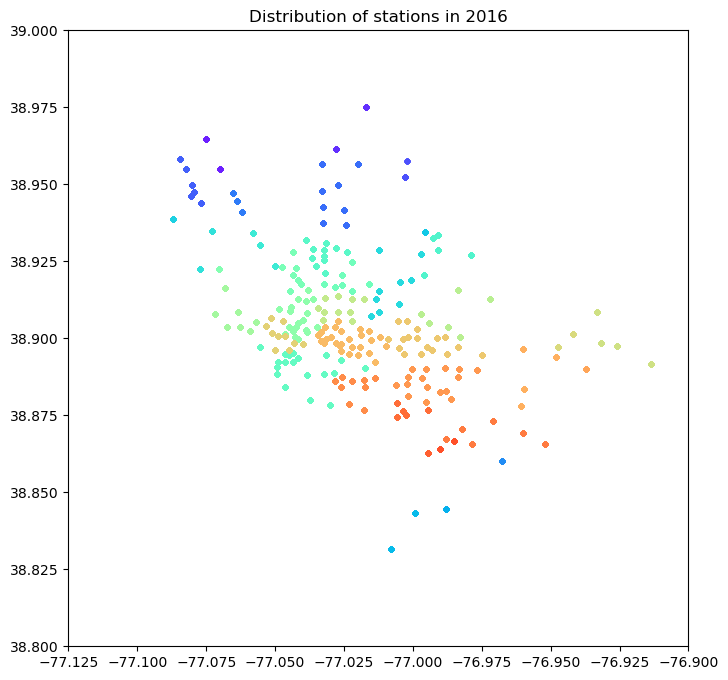

7


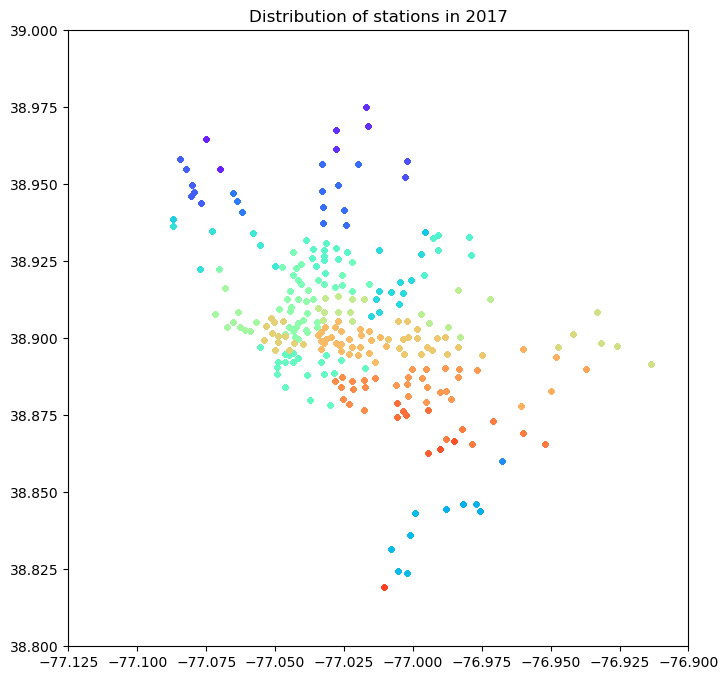

8


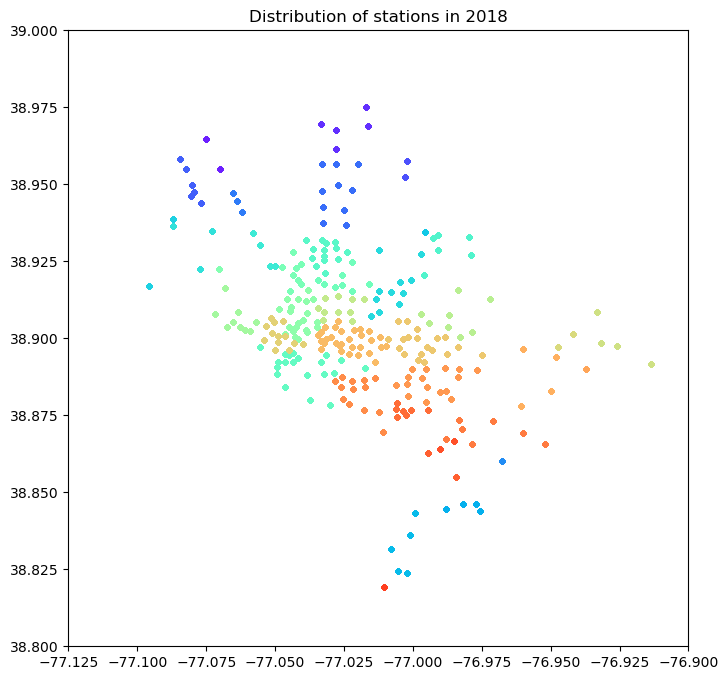

9


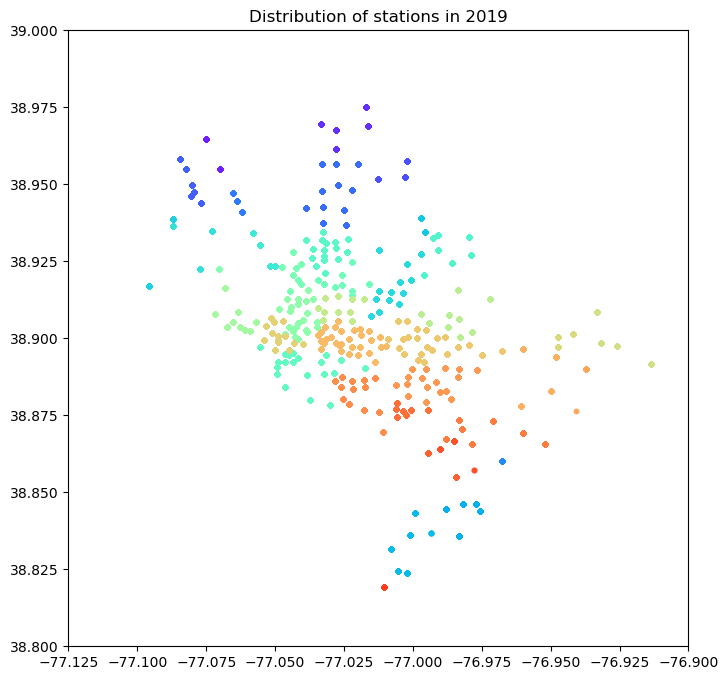

10


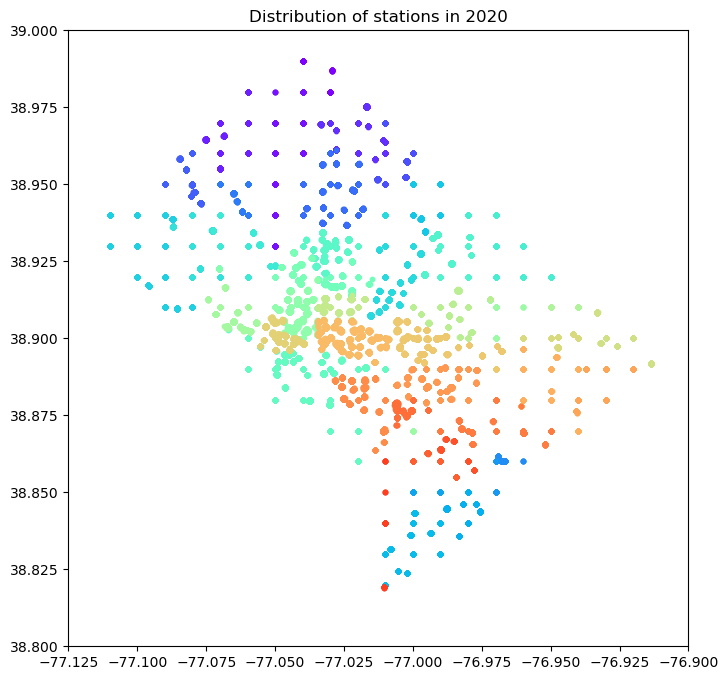

11


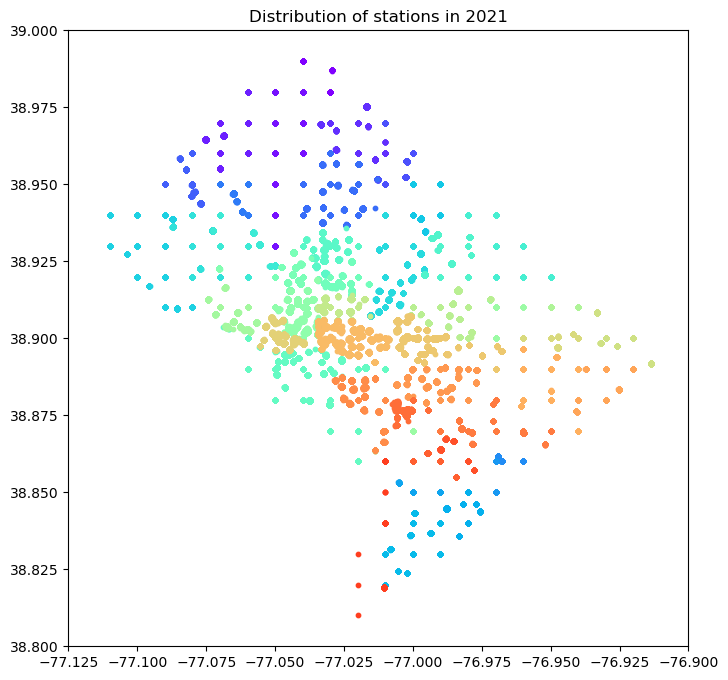

12


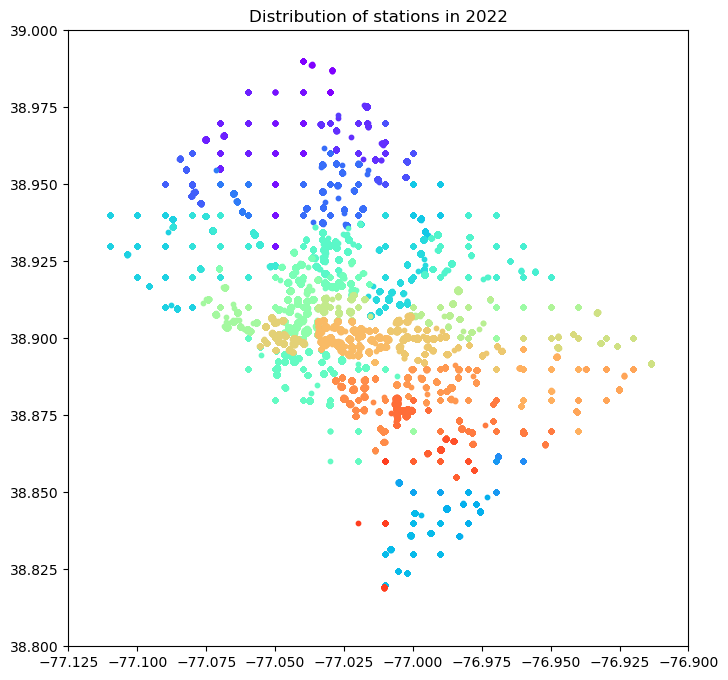

13


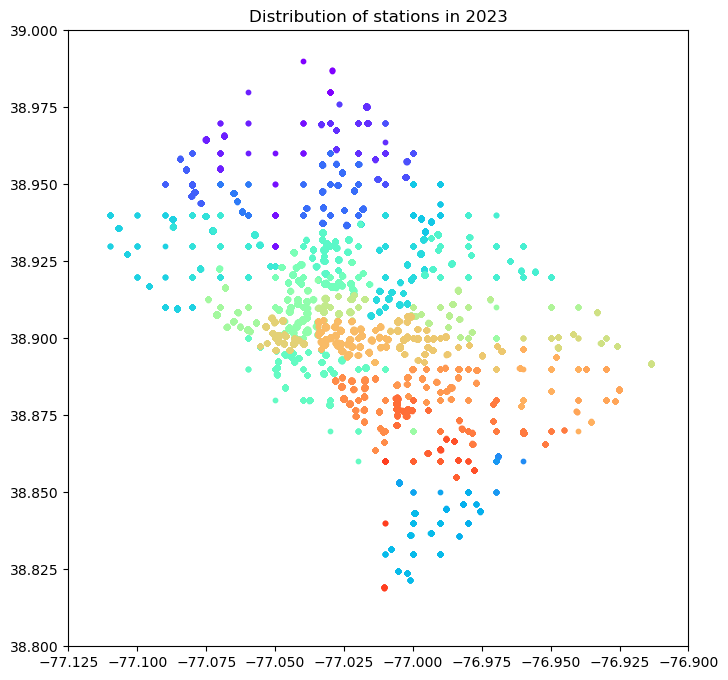

In [86]:

for y, data in enumerate(points_with_wards.groupby(points_with_wards.started_at.dt.year)):
    #print(y)
    i = 0
    plt.figure(figsize=(8, 8))
    plt.axis([-77.125, -76.9, 38.8, 39])
    plt.title('Distribution of stations in ' + str(data[0]))
    for x in data[1].groupby("index_right"):
        plt.scatter(x[1].start_lng, x[1].start_lat, s=10, color=colors[x[0]])
        i = i + 1

    # Display the plot
    plt.show()

In [75]:
points_with_wards.head()

,duration,started_at,ended_at,start_station_id,start_station_name,end_station_id,end_station_name,bike_number,member_casual,_filter,...,start_lat,start_lng,end_lat,end_lng,distance,speed,ride_id,rideable_type,geometry,index_right
0,1012.0,2010-09-20 11:27:04,2010-09-20 11:43:56,31208,M St & New Jersey Ave SE,31108,4th & M St SW,W00742,member,0,...,38.8763,-77.0037,38.876697,-77.017898,1.229804,4.374796,NaN,NaN,POINT (-77.00370 38.87630),42
1,61.0,2010-09-20 11:41:22,2010-09-20 11:42:23,31209,1st & N St SE,31209,1st & N St SE,W00032,member,1,...,38.8743,-77.0057,38.874300,-77.005700,0.000000,0.000000,NaN,NaN,POINT (-77.00570 38.87430),42
46,1488.0,2010-09-20 15:51:30,2010-09-20 16:16:18,31208,M St & New Jersey Ave SE,31600,5th & K St NW,W01084,member,0,...,38.8763,-77.0037,38.903040,-77.019027,3.255846,7.877047,NaN,NaN,POINT (-77.00370 38.87630),42
69,1796.0,2010-09-20 17:31:06,2010-09-20 18:01:02,31208,M St & New Jersey Ave SE,31204,20th & E St NW,W00428,member,0,...,38.8763,-77.0037,38.896300,-77.045000,4.209974,8.438701,NaN,NaN,POINT (-77.00370 38.87630),42
77,959.0,2010-09-20 17:47:35,2010-09-20 18:03:34,31208,M St & New Jersey Ave SE,31208,M St & New Jersey Ave SE,W00826,member,0,...,38.8763,-77.0037,38.876300,-77.003700,0.000000,0.000000,NaN,NaN,POINT (-77.00370 38.87630),42


In [52]:
[points_with_wards.index_right == 0].points_with_wardsgroupby("start_station_name")["start_lat", "start_lng"].head()

,start_lat,start_lng
27044976,38.986881,-77.029359
27290809,38.986818,-77.029371
27360503,38.986956,-77.029441
27360521,38.986965,-77.029429
27360593,38.986976,-77.029449
31887927,38.988825,-77.036574
32003052,38.988900,-77.036634
32003053,38.988853,-77.036819
32139615,38.988875,-77.036610
32140544,38.988879,-77.036628


In [ ]:
# # Create a scatter plot of the points, colored by ward
# sns.scatterplot(data=points_with_wards[(result._filter==0)], x="end_lng", y="end_lat", hue="index_right", palette="tab10")

# # Add axis labels and a title
# plt.xlabel("Longitude")
# plt.ylabel("Latitude")
# plt.title("All Points by Ward")

# # Display the plot
# plt.show()

In [ ]:
points_with_wards.loc[28999570]

duration                          11697.0
started_at            2021-05-05 15:21:27
ended_at              2021-05-05 18:36:24
start_station_id                        0
start_station_name                    NaN
end_station_id                          0
end_station_name                      NaN
bike_number                           NaN
member_casual                      member
_filter                                 0
date                  2021-05-05 00:00:00
start_lat                            38.9
start_lng                           -77.0
end_lat                             38.44
end_lng                            -76.86
distance                        52.573877
speed                           16.180726
ride_id                  31B8038FC502E043
rideable_type               electric_bike
geometry                 POINT (-77 38.9)
index_right                            35
Name: 28999570, dtype: object

In [ ]:
points_with_wards.groupby("index_right")["index_right"].count()

index_right
0         913
1        1933
2       60388
3       87681
4           3
5       39358
6      172016
7      507681
8      114627
9        3573
10       1403
11       1587
12       9607
13      14007
14      41748
15      63511
16     872999
17     177830
18     348849
19       5908
20     142819
21    1882930
22    3383493
23    1319413
24    1336639
25      57393
26    3685801
27       3122
28    1083292
29        765
30     347582
31    2244932
32       7440
33      10868
34    1742135
35    2706726
36    4443706
37      26991
38       8708
39    1996923
40    1492356
41      60687
42     592326
43      20202
44      16076
45        568
Name: index_right, dtype: int64